<a href="https://colab.research.google.com/github/UMassIonTrappers/quantum-computing-labs/blob/main/Lab_04_RWA_Rabi_oscillations_and_detuning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ECE 550/650

## Introduction to Quantum Computing

Robert Niffenegger (rniffenegger@umass.edu )


In [1]:
try:
  import qutip
except ImportError:
  print('Install Qutip')
  !pip install qutip

try:
  import qiskit
except ImportError:
  print('Install Qiskit')
  !pip install -q qiskit
  !pip install -q qiskit[visualization]
  !pip install -q git+https://github.com/qiskit-community/qiskit-textbook.git#subdirectory=qiskit-textbook-src

### Initialize

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from numpy import pi, sqrt, sin, cos
plt.style.use('default') #background can be set to 'dark_backgound'...
linewidth = 4
figsize=5
fs=15

from pylab import *
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML, display, Math

#QuTiP
import qutip as qt
from qutip import *
from qutip.qip import *
from qutip import qeye, tensor, destroy, fock_dm
from qutip.qip.circuit import Gate
from qutip.qip.operations import *
from qutip.measurement import measure, measurement_statistics

#QISKIT
from qiskit import QuantumCircuit, transpile, assemble
from qiskit.visualization import plot_bloch_multivector, plot_histogram
from qiskit.quantum_info import Statevector
from qiskit_aer import QasmSimulator

#Future add: https://qopt.readthedocs.io/en/latest/examples/rabi_rwa.html

# Lab 3 - Part B

Remember, rotation of the qubit state is due to the time evolution of the wavefunction set by the time dependent Schrödinger equation:

### $ \mathrm{i} \hbar \frac{\partial}{\partial t} | \,\psi (t) \rangle = \hat{H} | \,\psi (t) \rangle $

The Hamiltonian ${\hat {H}}$ will  describes the energy of the system and the Time dependent Schrödinger equation sets how the states evolve due to the Hamiltonian.

If the Hamiltonian ${\hat {H}}$ is constant in time, then the Schrödinger equation has the solution.

## $ |\Psi (t)\rangle =e^{-i{\hat {H}}t/\hbar }|\Psi (0)\rangle$


In [3]:
# Initialize a superposition state so we can see the rotation
psi0 = spin_state( 1/2, +1/2) + spin_state( 1/2, -1/2)
psi0=psi0.unit() #Normalize (or use correct sqrt(2) coefficients)

H = 1/2*sigmaz()  # setup the Hamiltonian

times = np.linspace(0, 2 * 2*pi, 50) # 2 periods of rotation at omega_z

'''Run the 'simulation'''
result = sesolve(H, psi0, times, [])

'''Store the projection measurements for each basis'''
sz =  expect(sigmaz(), result.states)
sy =  expect(sigmay(), result.states)
sx =  expect(sigmax(), result.states)


fig = plt.figure(figsize=(figsize, figsize))
fig.suptitle(r'Evolution of |+$\rangle$ about Z axis from S.E.', fontsize=16)
ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!
sphere = Bloch(axes=ax)
sphere.vector_color = ['r','grey','grey','grey']
sphere.point_color = ['r']

#Animation function
def animate(i):
    sphere.clear()
    sphere.vector_color = ['r','grey','grey','grey','b']

    sphere.add_points([sx[:i+1],sy[:i+1],sz[:i+1]], meth='l') #Point for each step of the rotation
    sphere.add_vectors([sx[i],sy[i],sz[i]]) #Full vector from the simulation
    sphere.add_vectors([sx[i],0,0]) #Just the X basis component
    sphere.add_vectors([0,sy[i],0]) #Just the Y basis component
    sphere.add_vectors([0,0,sz[i]]) #Just the Z basis component
    sphere.add_vectors([0,0,1]) #Rotation about Z axis
    sphere.zlabel = ['z $ \circlearrowleft $', '' ]

    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(sx)),init_func=init, blit=False, repeat=True)
plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())

In [4]:
'''Setup toy Hamiltonian and initial state'''
psi0 = spin_state( 1/2, 1/2) # Initialize the 'up' (|0>) state

Omega_Rabi = 2*pi*1 # 1 revolution / second = 2 pi radians / second

omega_z = 2*pi*1 # 1 revolution / second = 2 pi radians / second

H_x = 1/2*Omega_Rabi*sigmax()  # Hamiltonian for X rotation from Rabi Coupling

H_z = 1/2*omega_z*sigmaz() # Hamiltonian for Z rotation from Zeeman splitting

'''Specify times to integrate over each Hamiltonian'''
t_steps = 20
BS1_times = np.linspace(0, 1/4, t_steps)    # 1/4 of 2pi = pi/2 rotation
Z_times = np.linspace(0, 1/2, t_steps)      # 1/2 of 2pi = pi   rotation
BS2_times = np.linspace(0, 1/4, t_steps)    # 1/4 of 2pi = pi/2 rotation

'''
Run the numerical integration of the Schrodinger Equation

    1. Beam splitter 1 ( pi/2 rotation about X)
    2. Phase inversion (pi rotation about Z)
    3. Beam splitter 2 ( pi/2 rotation about X)

    * Pass the wavefunction to each subsequent integration step
    * Append all of the expectation values

'''
# Beam splitter #1
result = sesolve(H_x, psi0, BS1_times, [])
sz =  expect(sigmaz(), result.states)
sy =  expect(sigmay(), result.states)
sx =  expect(sigmax(), result.states)

# Pi rotation about z
result = sesolve(H_z, result.states[-1], Z_times, [])
sz = np.append(sz, expect(sigmaz(), result.states))
sy = np.append(sy, expect(sigmay(), result.states))
sx = np.append(sx, expect(sigmax(), result.states))

# Beam Splitter #2
result = sesolve(H_x, result.states[-1], BS2_times, [])
sz = np.append(sz, expect(sigmaz(), result.states))
sy = np.append(sy, expect(sigmay(), result.states))
sx = np.append(sx, expect(sigmax(), result.states))

'''Animate on the Bloch sphere'''
fig = plt.figure(figsize=(figsize,figsize))
fig.suptitle(r'Integrating the Schrödinger Equation', fontsize=16)
ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!
sphere = Bloch(axes=ax)
sphere.vector_color = ['b','r','grey','grey']
sphere.point_color = ['b']

#Animation function
def animate(i):
    sphere.clear()
    sphere.vector_color = ['b','r','grey','grey']

    if i < t_steps:
        fig.suptitle(r'Integrating the Schrödinger Eqn $X(\frac{\pi}{2})$', fontsize=16)
        sphere.add_vectors([1,0,0]) #Add vector on X axis representing rotation axis
    elif i < 2*t_steps:
        fig.suptitle(r'Integrating the Schrödinger Eqn $Z(\pi)$', fontsize=16)
        sphere.add_vectors([0,0,1]) #Add vector on Z axis representing rotation axis
    else:
        fig.suptitle(r'Integrating the Schrödinger Eqn $X(\frac{\pi}{2})$', fontsize=16)
        sphere.add_vectors([1,0,0]) #Add vector on X axis representing rotation axis

    sphere.add_points([sx[:i+1],sy[:i+1],sz[:i+1]], meth='l') #Point for each step of the rotation
    sphere.add_vectors([sx[i],sy[i],sz[i]]) #Full vector from the simulation
    sphere.add_vectors([0,sy[i],0]) #Y basis component
    sphere.add_vectors([0,0,sz[i]]) #Z basis component
    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani1 = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(sx)),init_func=init, blit=False, repeat=True)
plt.close()  # Prevent display of static figure
HTML(ani1.to_jshtml())

# Rabi oscillation on resonance ($\delta = 0$)

In [8]:
# Initialize the state
psi0 = spin_state( 1/2, +1/2)
psi0=psi0.unit() #Normalize

'''Setup the Hamiltonian'''
H_detuning = 0*1/2*sigmaz()

H_Rabi_coupling = 1/2 * sigmax()

'''Adding both terms of the Hamiltonian we can then numerically integrate the state trajectory'''
H_total = H_detuning + H_Rabi_coupling

# List of times for which the solver should store the state vector
times = np.linspace(0, 2*pi, 50) # 2 periods of rotation at omega

'''Run the simulation'''
result = sesolve(H_total, psi0, times, [])

'''Store the projection measurements for each basis'''
sz =  expect(sigmaz(), result.states)
sy =  expect(sigmay(), result.states)
sx =  expect(sigmax(), result.states)

In [9]:
'''Animate on the Bloch sphere'''
fig = plt.figure(figsize=(figsize,figsize))
fig.suptitle(r'Integrating the Schrödinger Equation', fontsize=16)
ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!
sphere = Bloch(axes=ax)
sphere.vector_color = ['r','grey','grey','grey']
sphere.point_color = ['r']

#Animation function
def animate(i):
    sphere.clear()
    sphere.vector_color = ['r','grey','grey','grey']

    sphere.add_points([sx[:i+1],sy[:i+1],sz[:i+1]], meth='l') #Point for each step of the rotation
    sphere.add_vectors([sx[i],sy[i],sz[i]]) #Full vector from the simulation
    sphere.add_vectors([sx[i],0,0]) #Just the X basis component
    sphere.add_vectors([0,sy[i],0]) #Just the Y basis component
    sphere.add_vectors([0,0,sz[i]]) #Just the Z basis component
    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(sx)),init_func=init, blit=False, repeat=True)
plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())


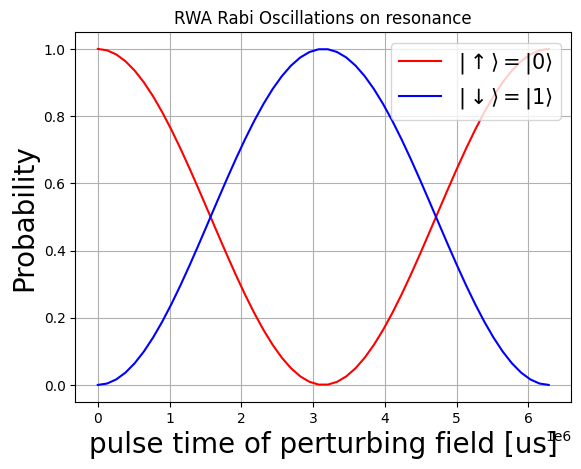

In [10]:
psi_down = spin_state( 1/2, -1/2)
psi_up = spin_state( 1/2, +1/2)

#Extract the expectation values of being in each state
prob_up =  expect(psi_up*psi_up.dag(), result.states)
prob_down =  expect(psi_down*psi_down.dag(), result.states)

fig, ax = plt.subplots(1,1)
plt.grid()
ax.plot(times*1e6, prob_up,'-r')
ax.plot(times*1e6, prob_down,'-b')
plt.title('RWA Rabi Oscillations on resonance')
ax.set_xlabel(r'pulse time of perturbing field [us]', fontsize=20)
ax.set_ylabel(r'Probability', fontsize=20)
ax.legend((r'$|\uparrow\rangle=|0\rangle$',
            r'$|\downarrow\rangle=|1\rangle$'),loc=1,fontsize=15)

What if the detuning not on resonance? What if the applied perturbation field has the wrong frequency?



# Rabi oscillation OFF resonance (detuned)

In [11]:
psi0 = spin_state( 1/2, +1/2)
psi0=psi0.unit()


'''Setup the Hamiltonian'''
H_detuning = 1/2*sigmaz()

H_Rabi_coupling = 1/2 * sigmax()

H_total = H_detuning + H_Rabi_coupling

times = np.linspace(0, 2*pi, 50) # 2 periods of rotation at omega

'''Run the simulation'''
result = sesolve(H_total, psi0, times, [])

'''Store the projection measurements for each basis'''
sz =  expect(sigmaz(), result.states)
sy =  expect(sigmay(), result.states)
sx =  expect(sigmax(), result.states)

In [12]:
'''Animate on the Bloch sphere'''

fig = plt.figure(figsize=(figsize,figsize))
fig.suptitle(r'Integrating the Schrödinger Equation', fontsize=16)
ax = fig.add_subplot(111, projection='3d') #MUST BE SUBPLOT --- WILL NOT WORK with 'Axes3d'!!!!!!

sphere = Bloch(axes=ax)
sphere.vector_color = ['r','grey','grey','grey']
sphere.point_color = ['r']

#Animation function
def animate(i):
    sphere.clear()
    sphere.vector_color = ['r','grey','grey','grey']

    sphere.add_points([sx[:i+1],sy[:i+1],sz[:i+1]], meth='l') #Point for each step of the rotation
    sphere.add_vectors([sx[i],sy[i],sz[i]]) #Full vector from the simulation
    sphere.add_vectors([sx[i],0,0]) #Just the X basis component
    sphere.add_vectors([0,sy[i],0]) #Just the Y basis component
    sphere.add_vectors([0,0,sz[i]]) #Just the Z basis component
    sphere.make_sphere()
    return ax

def init():
    sphere.vector_color = ['r']
    return ax

ani = matplotlib.animation.FuncAnimation(fig, animate, np.arange(len(sx)),init_func=init, blit=False, repeat=True)
plt.close()  # Prevent display of static figure
HTML(ani.to_jshtml())


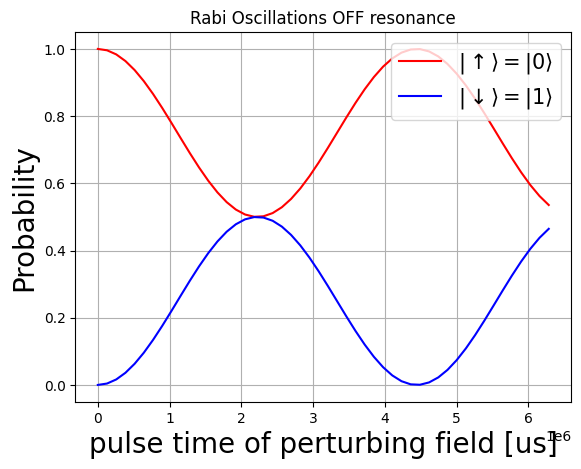

In [13]:
#Extract the expectation values of being in each state
prob_up =  expect(psi_up*psi_up.dag(), result.states)
prob_down =  expect(psi_down*psi_down.dag(), result.states)

fig, ax = plt.subplots(1,1)
plt.grid()

ax.plot(times*1e6, prob_up,'-r')
ax.plot(times*1e6, prob_down,'-b')
plt.title('Rabi Oscillations OFF resonance')
ax.set_xlabel(r'pulse time of perturbing field [us]', fontsize=20)
ax.set_ylabel(r'Probability', fontsize=20);
ax.legend((r'$|\uparrow\rangle=|0\rangle$',
            r'$|\downarrow\rangle=|1\rangle$'),loc=1,fontsize=15);